# PA D206

### Importing packages

In [1]:
import pandas as pd
import numpy as np
import scipy
import matplotlib.pyplot as plt
import missingno as msno
import seaborn as sns

### Set options to see all coulmns and rows in the DataFrame

In [2]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

### Loading data to the Dataframe

In [3]:
data = pd.read_csv('churn data/churn_raw_data.csv')

### Making a copy of the data

In [4]:
df = data.copy(deep=True)

In [5]:
df.head()

,Unnamed: 0,CaseOrder,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Techie,Contract,Port_modem,Tablet,InternetService,Phone,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
0,1,1,K409198,aa90260b-4141-4a24-8e36-b04ce1f4f77b,Point Baker,AK,Prince of Wales-Hyder,99927,56.25100,-133.37571,38,Urban,America/Sitka,Environmental health practitioner,NaN,68.0,Master's Degree,Part Time,28561.99,Widowed,Male,No,6.972566,10,0,1,No,One year,Yes,Yes,Fiber Optic,Yes,No,Yes,Yes,No,No,No,Yes,Yes,Credit Card (automatic),6.795513,171.449762,904.536110,5,5,5,3,4,4,3,4
1,2,2,S120509,fb76459f-c047-4a9d-8af9-e0f7d4ac2524,West Branch,MI,Ogemaw,48661,44.32893,-84.24080,10446,Urban,America/Detroit,"Programmer, multimedia",1.0,27.0,Regular High School Diploma,Retired,21704.77,Married,Female,Yes,12.014541,12,0,1,Yes,Month-to-month,No,Yes,Fiber Optic,Yes,Yes,Yes,No,No,No,Yes,Yes,Yes,Bank Transfer(automatic),1.156681,242.948015,800.982766,3,4,3,3,4,3,4,4
2,3,3,K191035,344d114c-3736-4be5-98f7-c72c281e2d35,Yamhill,OR,Yamhill,97148,45.35589,-123.24657,3735,Urban,America/Los_Angeles,Chief Financial Officer,4.0,50.0,Regular High School Diploma,Student,NaN,Widowed,Female,No,10.245616,9,0,1,Yes,Two Year,Yes,No,DSL,Yes,Yes,No,No,No,No,No,Yes,Yes,Credit Card (automatic),15.754144,159.440398,2054.706961,4,4,2,4,4,3,3,3
3,4,4,D90850,abfa2b40-2d43-4994-b15a-989b8c79e311,Del Mar,CA,San Diego,92014,32.96687,-117.24798,13863,Suburban,America/Los_Angeles,Solicitor,1.0,48.0,Doctorate Degree,Retired,18925.23,Married,Male,No,15.206193,15,2,0,Yes,Two Year,No,No,DSL,Yes,No,Yes,No,No,No,Yes,No,Yes,Mailed Check,17.087227,120.249493,2164.579412,4,4,4,2,5,4,3,3
4,5,5,K662701,68a861fd-0d20-4e51-a587-8a90407ee574,Needville,TX,Fort Bend,77461,29.38012,-95.80673,11352,Suburban,America/Chicago,Medical illustrator,0.0,83.0,Master's Degree,Student,40074.19,Separated,Male,Yes,8.960316,16,2,1,No,Month-to-month,Yes,No,Fiber Optic,No,No,No,No,No,Yes,Yes,No,No,Mailed Check,1.670972,150.761216,271.493436,4,4,4,3,4,4,4,5


### Exploring the structure of the data

In [6]:
df.shape

(10000, 52)

#### Data set has 10000 rows and 52 columns

In [7]:
# Get information about all variables in the DataFrame, data type and column names 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 52 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Unnamed: 0            10000 non-null  int64  
 1   CaseOrder             10000 non-null  int64  
 2   Customer_id           10000 non-null  object 
 3   Interaction           10000 non-null  object 
 4   City                  10000 non-null  object 
 5   State                 10000 non-null  object 
 6   County                10000 non-null  object 
 7   Zip                   10000 non-null  int64  
 8   Lat                   10000 non-null  float64
 9   Lng                   10000 non-null  float64
 10  Population            10000 non-null  int64  
 11  Area                  10000 non-null  object 
 12  Timezone              10000 non-null  object 
 13  Job                   10000 non-null  object 
 14  Children              7505 non-null   float64
 15  Age                 

### Describe numerical variables (columns) and number of columns

In [8]:
print(f'Number of numerical columns: {df.describe().shape[1]}')
df.describe()

Number of numerical columns: 24


,Unnamed: 0,CaseOrder,Zip,Lat,Lng,Population,Children,Age,Income,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
count,10000.00000,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,7505.000000,7525.000000,7510.000000,10000.000000,10000.000000,10000.000000,10000.000000,9069.000000,10000.000000,8979.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,5000.50000,5000.50000,49153.319600,38.757567,-90.782536,9756.562400,2.095936,53.275748,39936.762226,11.452955,12.016000,0.994200,0.398000,34.498858,174.076305,3398.842752,3.490800,3.505100,3.487000,3.497500,3.492900,3.497300,3.509500,3.495600
std,2886.89568,2886.89568,27532.196108,5.437389,15.156142,14432.698671,2.154758,20.753928,28358.469482,7.025921,3.025898,0.988466,0.635953,26.438904,43.335473,2187.396807,1.037797,1.034641,1.027977,1.025816,1.024819,1.033586,1.028502,1.028633
min,1.00000,1.00000,601.000000,17.966120,-171.688150,0.000000,0.000000,18.000000,740.660000,-1.348571,1.000000,0.000000,0.000000,1.000259,77.505230,155.506715,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,2500.75000,2500.75000,26292.500000,35.341828,-97.082812,738.000000,0.000000,35.000000,19285.522500,8.054362,10.000000,0.000000,0.000000,7.890442,141.071078,1234.110529,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
50%,5000.50000,5000.50000,48869.500000,39.395800,-87.918800,2910.500000,1.000000,53.000000,33186.785000,10.202896,12.000000,1.000000,0.000000,36.196030,169.915400,3382.424000,3.000000,4.000000,3.000000,3.000000,3.000000,3.000000,4.000000,3.000000
75%,7500.25000,7500.25000,71866.500000,42.106908,-80.088745,13168.000000,3.000000,71.000000,53472.395000,12.487644,14.000000,2.000000,1.000000,61.426670,203.777441,5587.096500,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
max,10000.00000,10000.00000,99929.000000,70.640660,-65.667850,111850.000000,10.000000,89.000000,258900.700000,47.049280,23.000000,7.000000,6.000000,71.999280,315.878600,7158.982000,7.000000,7.000000,8.000000,7.000000,7.000000,8.000000,7.000000,8.000000


##### Columns "item1" to "item8" have numeric values but looks more like those are categorical data expresed numericaly.

In [9]:
# Check columns item1 to item8

print(sorted(df.item1.unique()))
print(sorted(df.item2.unique()))
print(sorted(df.item3.unique()))
print(sorted(df.item4.unique()))
print(sorted(df.item5.unique()))
print(sorted(df.item6.unique()))
print(sorted(df.item7.unique()))
print(sorted(df.item8.unique()))

[1, 2, 3, 4, 5, 6, 7]
[1, 2, 3, 4, 5, 6, 7]
[1, 2, 3, 4, 5, 6, 7, 8]
[1, 2, 3, 4, 5, 6, 7]
[1, 2, 3, 4, 5, 6, 7]
[1, 2, 3, 4, 5, 6, 7, 8]
[1, 2, 3, 4, 5, 6, 7]
[1, 2, 3, 4, 5, 6, 7, 8]


##### "itemX" could refer to the id of and item for that reason I will convert that variable as categorical variable

In [10]:
df.item1 = df.item1.astype('category')
df.item2 = df.item2.astype('category')
df.item3 = df.item3.astype('category')
df.item4 = df.item4.astype('category')
df.item5 = df.item5.astype('category')
df.item6 = df.item6.astype('category')
df.item7 = df.item7.astype('category')
df.item8 = df.item8.astype('category')

In [11]:
print(f'Number of numerical columns: {df.describe().shape[1]}')
df.describe()

Number of numerical columns: 16


,Unnamed: 0,CaseOrder,Zip,Lat,Lng,Population,Children,Age,Income,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Tenure,MonthlyCharge,Bandwidth_GB_Year
count,10000.00000,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,7505.000000,7525.000000,7510.000000,10000.000000,10000.000000,10000.000000,10000.000000,9069.000000,10000.000000,8979.000000
mean,5000.50000,5000.50000,49153.319600,38.757567,-90.782536,9756.562400,2.095936,53.275748,39936.762226,11.452955,12.016000,0.994200,0.398000,34.498858,174.076305,3398.842752
std,2886.89568,2886.89568,27532.196108,5.437389,15.156142,14432.698671,2.154758,20.753928,28358.469482,7.025921,3.025898,0.988466,0.635953,26.438904,43.335473,2187.396807
min,1.00000,1.00000,601.000000,17.966120,-171.688150,0.000000,0.000000,18.000000,740.660000,-1.348571,1.000000,0.000000,0.000000,1.000259,77.505230,155.506715
25%,2500.75000,2500.75000,26292.500000,35.341828,-97.082812,738.000000,0.000000,35.000000,19285.522500,8.054362,10.000000,0.000000,0.000000,7.890442,141.071078,1234.110529
50%,5000.50000,5000.50000,48869.500000,39.395800,-87.918800,2910.500000,1.000000,53.000000,33186.785000,10.202896,12.000000,1.000000,0.000000,36.196030,169.915400,3382.424000
75%,7500.25000,7500.25000,71866.500000,42.106908,-80.088745,13168.000000,3.000000,71.000000,53472.395000,12.487644,14.000000,2.000000,1.000000,61.426670,203.777441,5587.096500
max,10000.00000,10000.00000,99929.000000,70.640660,-65.667850,111850.000000,10.000000,89.000000,258900.700000,47.049280,23.000000,7.000000,6.000000,71.999280,315.878600,7158.982000


##### Looks like the column 'Unnamed: 0' has the same value of the 'CaseOrder' columns and match the row number(observation).

In [12]:
# Check if  'Unnamed: 0' and 'CaseOrder' are equal to drop it and use case order as the index of the data
df['Unnamed: 0'].equals(df['CaseOrder'])

True

In [13]:
df.head()

,Unnamed: 0,CaseOrder,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Techie,Contract,Port_modem,Tablet,InternetService,Phone,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
0,1,1,K409198,aa90260b-4141-4a24-8e36-b04ce1f4f77b,Point Baker,AK,Prince of Wales-Hyder,99927,56.25100,-133.37571,38,Urban,America/Sitka,Environmental health practitioner,NaN,68.0,Master's Degree,Part Time,28561.99,Widowed,Male,No,6.972566,10,0,1,No,One year,Yes,Yes,Fiber Optic,Yes,No,Yes,Yes,No,No,No,Yes,Yes,Credit Card (automatic),6.795513,171.449762,904.536110,5,5,5,3,4,4,3,4
1,2,2,S120509,fb76459f-c047-4a9d-8af9-e0f7d4ac2524,West Branch,MI,Ogemaw,48661,44.32893,-84.24080,10446,Urban,America/Detroit,"Programmer, multimedia",1.0,27.0,Regular High School Diploma,Retired,21704.77,Married,Female,Yes,12.014541,12,0,1,Yes,Month-to-month,No,Yes,Fiber Optic,Yes,Yes,Yes,No,No,No,Yes,Yes,Yes,Bank Transfer(automatic),1.156681,242.948015,800.982766,3,4,3,3,4,3,4,4
2,3,3,K191035,344d114c-3736-4be5-98f7-c72c281e2d35,Yamhill,OR,Yamhill,97148,45.35589,-123.24657,3735,Urban,America/Los_Angeles,Chief Financial Officer,4.0,50.0,Regular High School Diploma,Student,NaN,Widowed,Female,No,10.245616,9,0,1,Yes,Two Year,Yes,No,DSL,Yes,Yes,No,No,No,No,No,Yes,Yes,Credit Card (automatic),15.754144,159.440398,2054.706961,4,4,2,4,4,3,3,3
3,4,4,D90850,abfa2b40-2d43-4994-b15a-989b8c79e311,Del Mar,CA,San Diego,92014,32.96687,-117.24798,13863,Suburban,America/Los_Angeles,Solicitor,1.0,48.0,Doctorate Degree,Retired,18925.23,Married,Male,No,15.206193,15,2,0,Yes,Two Year,No,No,DSL,Yes,No,Yes,No,No,No,Yes,No,Yes,Mailed Check,17.087227,120.249493,2164.579412,4,4,4,2,5,4,3,3
4,5,5,K662701,68a861fd-0d20-4e51-a587-8a90407ee574,Needville,TX,Fort Bend,77461,29.38012,-95.80673,11352,Suburban,America/Chicago,Medical illustrator,0.0,83.0,Master's Degree,Student,40074.19,Separated,Male,Yes,8.960316,16,2,1,No,Month-to-month,Yes,No,Fiber Optic,No,No,No,No,No,Yes,Yes,No,No,Mailed Check,1.670972,150.761216,271.493436,4,4,4,3,4,4,4,5


In [18]:
# Droping 'Unnamed: 0' and 'CaseOrder'columns due that the Index can be use as the order of the DataFrame
# and the Customer_id can be use to unique identify every customer
df.drop(columns=['Unnamed: 0', 'CaseOrder'], axis=1 ,inplace=True)

In [19]:
df.head()

,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Techie,Contract,Port_modem,Tablet,InternetService,Phone,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
0,K409198,aa90260b-4141-4a24-8e36-b04ce1f4f77b,Point Baker,AK,Prince of Wales-Hyder,99927,56.25100,-133.37571,38,Urban,America/Sitka,Environmental health practitioner,NaN,68.0,Master's Degree,Part Time,28561.99,Widowed,Male,No,6.972566,10,0,1,No,One year,Yes,Yes,Fiber Optic,Yes,No,Yes,Yes,No,No,No,Yes,Yes,Credit Card (automatic),6.795513,171.449762,904.536110,5,5,5,3,4,4,3,4
1,S120509,fb76459f-c047-4a9d-8af9-e0f7d4ac2524,West Branch,MI,Ogemaw,48661,44.32893,-84.24080,10446,Urban,America/Detroit,"Programmer, multimedia",1.0,27.0,Regular High School Diploma,Retired,21704.77,Married,Female,Yes,12.014541,12,0,1,Yes,Month-to-month,No,Yes,Fiber Optic,Yes,Yes,Yes,No,No,No,Yes,Yes,Yes,Bank Transfer(automatic),1.156681,242.948015,800.982766,3,4,3,3,4,3,4,4
2,K191035,344d114c-3736-4be5-98f7-c72c281e2d35,Yamhill,OR,Yamhill,97148,45.35589,-123.24657,3735,Urban,America/Los_Angeles,Chief Financial Officer,4.0,50.0,Regular High School Diploma,Student,NaN,Widowed,Female,No,10.245616,9,0,1,Yes,Two Year,Yes,No,DSL,Yes,Yes,No,No,No,No,No,Yes,Yes,Credit Card (automatic),15.754144,159.440398,2054.706961,4,4,2,4,4,3,3,3
3,D90850,abfa2b40-2d43-4994-b15a-989b8c79e311,Del Mar,CA,San Diego,92014,32.96687,-117.24798,13863,Suburban,America/Los_Angeles,Solicitor,1.0,48.0,Doctorate Degree,Retired,18925.23,Married,Male,No,15.206193,15,2,0,Yes,Two Year,No,No,DSL,Yes,No,Yes,No,No,No,Yes,No,Yes,Mailed Check,17.087227,120.249493,2164.579412,4,4,4,2,5,4,3,3
4,K662701,68a861fd-0d20-4e51-a587-8a90407ee574,Needville,TX,Fort Bend,77461,29.38012,-95.80673,11352,Suburban,America/Chicago,Medical illustrator,0.0,83.0,Master's Degree,Student,40074.19,Separated,Male,Yes,8.960316,16,2,1,No,Month-to-month,Yes,No,Fiber Optic,No,No,No,No,No,Yes,Yes,No,No,Mailed Check,1.670972,150.761216,271.493436,4,4,4,3,4,4,4,5


In [20]:
# Again check for the amount of numerical variables 
print(f'Number of numerical columns: {df.describe().shape[1]}')
df.describe()

Number of numerical columns: 14


,Zip,Lat,Lng,Population,Children,Age,Income,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Tenure,MonthlyCharge,Bandwidth_GB_Year
count,10000.000000,10000.000000,10000.000000,10000.000000,7505.000000,7525.000000,7510.000000,10000.000000,10000.000000,10000.000000,10000.000000,9069.000000,10000.000000,8979.000000
mean,49153.319600,38.757567,-90.782536,9756.562400,2.095936,53.275748,39936.762226,11.452955,12.016000,0.994200,0.398000,34.498858,174.076305,3398.842752
std,27532.196108,5.437389,15.156142,14432.698671,2.154758,20.753928,28358.469482,7.025921,3.025898,0.988466,0.635953,26.438904,43.335473,2187.396807
min,601.000000,17.966120,-171.688150,0.000000,0.000000,18.000000,740.660000,-1.348571,1.000000,0.000000,0.000000,1.000259,77.505230,155.506715
25%,26292.500000,35.341828,-97.082812,738.000000,0.000000,35.000000,19285.522500,8.054362,10.000000,0.000000,0.000000,7.890442,141.071078,1234.110529
50%,48869.500000,39.395800,-87.918800,2910.500000,1.000000,53.000000,33186.785000,10.202896,12.000000,1.000000,0.000000,36.196030,169.915400,3382.424000
75%,71866.500000,42.106908,-80.088745,13168.000000,3.000000,71.000000,53472.395000,12.487644,14.000000,2.000000,1.000000,61.426670,203.777441,5587.096500
max,99929.000000,70.640660,-65.667850,111850.000000,10.000000,89.000000,258900.700000,47.049280,23.000000,7.000000,6.000000,71.999280,315.878600,7158.982000


### Describing categorical columns

In [23]:
# Describe categorical variables
print(f'Number of categorical columns: {df.describe(exclude="number").shape[1]}')
df.describe(exclude='number')

Number of categorical columns: 36


,Customer_id,Interaction,City,State,County,Area,Timezone,Job,Education,Employment,Marital,Gender,Churn,Techie,Contract,Port_modem,Tablet,InternetService,Phone,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,item1,item2,item3,item4,item5,item6,item7,item8
count,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,7523,10000,10000,10000,10000,8974,10000,10000,10000,10000,9009,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000,10000
unique,10000,10000,6058,52,1620,3,25,639,12,5,5,3,2,2,3,2,2,3,2,2,2,2,2,2,2,2,2,4,7,7,8,7,7,8,7,8
top,Y285316,168bf348-88d3-4168-b035-20ff0f25a22b,Houston,TX,Washington,Suburban,America/New_York,Occupational psychologist,Regular High School Diploma,Full Time,Divorced,Female,No,No,Month-to-month,No,No,Fiber Optic,Yes,No,No,No,No,No,No,No,Yes,Electronic Check,3,3,3,4,3,3,4,3
freq,1,1,34,603,111,3346,4072,30,2421,5992,2092,5025,7350,6266,5456,5166,7009,4408,8128,5392,6424,5494,5614,5635,5071,5110,5882,3398,3448,3415,3435,3452,3462,3445,3456,3461


In [24]:
df.shape

(10000, 50)

### Checking for duplicate values

In [26]:
df.duplicated()

0       False
1       False
2       False
3       False
4       False
5       False
6       False
7       False
8       False
9       False
10      False
11      False
12      False
13      False
14      False
15      False
16      False
17      False
18      False
19      False
20      False
21      False
22      False
23      False
24      False
25      False
26      False
27      False
28      False
29      False
30      False
31      False
32      False
33      False
34      False
35      False
36      False
37      False
38      False
39      False
40      False
41      False
42      False
43      False
44      False
45      False
46      False
47      False
48      False
49      False
50      False
51      False
52      False
53      False
54      False
55      False
56      False
57      False
58      False
59      False
60      False
61      False
62      False
63      False
64      False
65      False
66      False
67      False
68      False
69      False
70      False
71    

In [27]:
# Looks like there are not duplicate values. double check with sum() function
df.duplicated().sum()

0

##### No duplicates values in the data, GREAT :) !

### Checking for null or missing values

In [28]:
# Checking the amount of null values by column
df.isnull().sum()

Customer_id                0
Interaction                0
City                       0
State                      0
County                     0
Zip                        0
Lat                        0
Lng                        0
Population                 0
Area                       0
Timezone                   0
Job                        0
Children                2495
Age                     2475
Education                  0
Employment                 0
Income                  2490
Marital                    0
Gender                     0
Churn                      0
Outage_sec_perweek         0
Email                      0
Contacts                   0
Yearly_equip_failure       0
Techie                  2477
Contract                   0
Port_modem                 0
Tablet                     0
InternetService            0
Phone                   1026
Multiple                   0
OnlineSecurity             0
OnlineBackup               0
DeviceProtection           0
TechSupport   

In [29]:
missing_values_percent = df.isnull().mean() * 100
print('Percentage of Missing Values:\n', missing_values_percent)

Percentage of Missing Values:
 Customer_id              0.00
Interaction              0.00
City                     0.00
State                    0.00
County                   0.00
Zip                      0.00
Lat                      0.00
Lng                      0.00
Population               0.00
Area                     0.00
Timezone                 0.00
Job                      0.00
Children                24.95
Age                     24.75
Education                0.00
Employment               0.00
Income                  24.90
Marital                  0.00
Gender                   0.00
Churn                    0.00
Outage_sec_perweek       0.00
Email                    0.00
Contacts                 0.00
Yearly_equip_failure     0.00
Techie                  24.77
Contract                 0.00
Port_modem               0.00
Tablet                   0.00
InternetService          0.00
Phone                   10.26
Multiple                 0.00
OnlineSecurity           0.00
OnlineBac

###### The column that have null values the amount of null values range from 10% to 25%. Null values should be imputed. 

### Get the name of the columns with missing values

In [30]:
# Print columns with null values
columns_to_impute = df.columns[df.isnull().any()]
print(df.columns[df.isnull().any()])
print()
print(f'Amount of coulmns with null values: {len(df.columns[df.isnull().any()])}')

Index(['Children', 'Age', 'Income', 'Techie', 'Phone', 'TechSupport', 'Tenure',
       'Bandwidth_GB_Year'],
      dtype='object')

Amount of coulmns with null values: 8


#### Link to the page that help me with the code

https://stackoverflow.com/questions/37366717/pandas-print-column-name-with-missing-values

### ## Visualize missing values with missingno package

<AxesSubplot:>

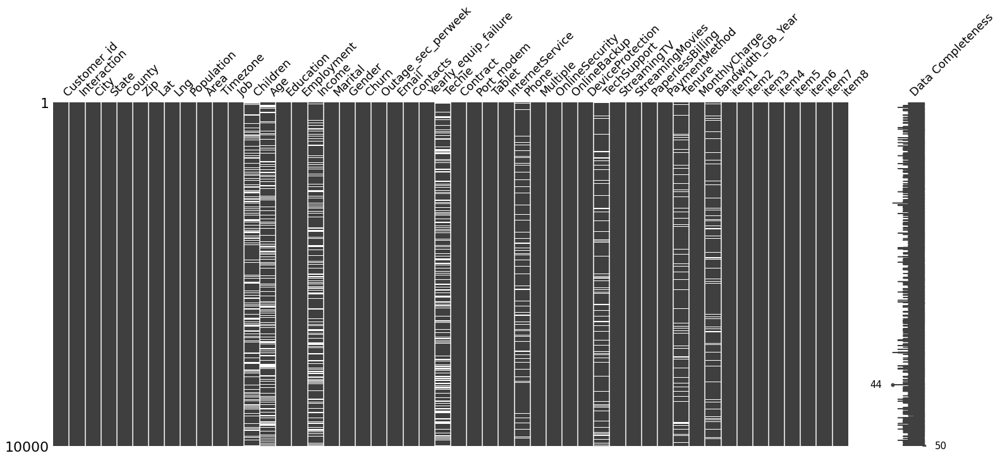

In [31]:
msno.matrix(df, fontsize=18 ,labels=True)

<AxesSubplot:>

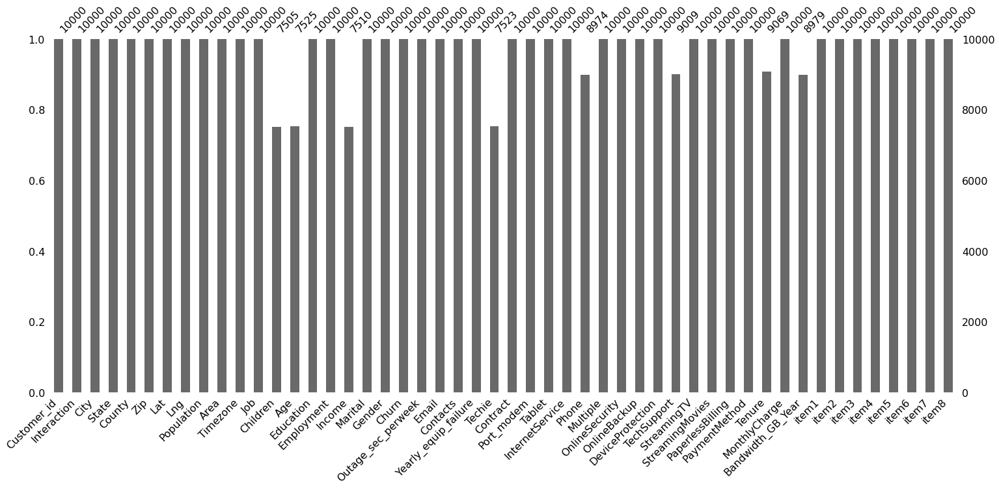

In [32]:
msno.bar(df)

<AxesSubplot:>

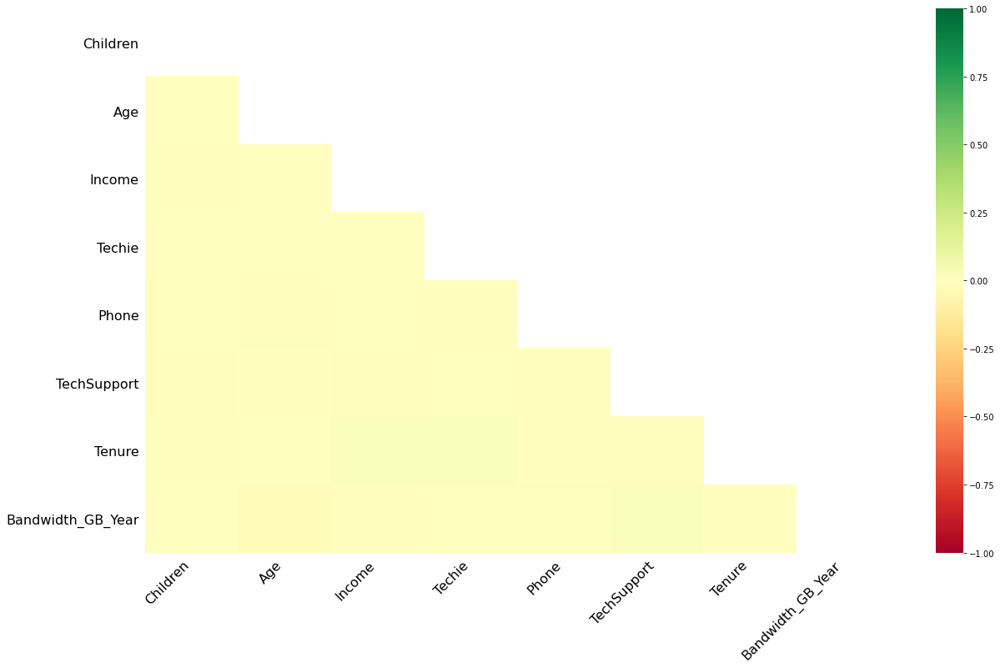

In [33]:
msno.heatmap(df, cmap="RdYlGn")

<ipython-input-38-1c0377c8321d>:2: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  df.hist(ax = fig.gca())


array([[<AxesSubplot:title={'center':'Zip'}>,
        <AxesSubplot:title={'center':'Lat'}>,
        <AxesSubplot:title={'center':'Lng'}>,
        <AxesSubplot:title={'center':'Population'}>],
       [<AxesSubplot:title={'center':'Children'}>,
        <AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Income'}>,
        <AxesSubplot:title={'center':'Outage_sec_perweek'}>],
       [<AxesSubplot:title={'center':'Email'}>,
        <AxesSubplot:title={'center':'Contacts'}>,
        <AxesSubplot:title={'center':'Yearly_equip_failure'}>,
        <AxesSubplot:title={'center':'Tenure'}>],
       [<AxesSubplot:title={'center':'MonthlyCharge'}>,
        <AxesSubplot:title={'center':'Bandwidth_GB_Year'}>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

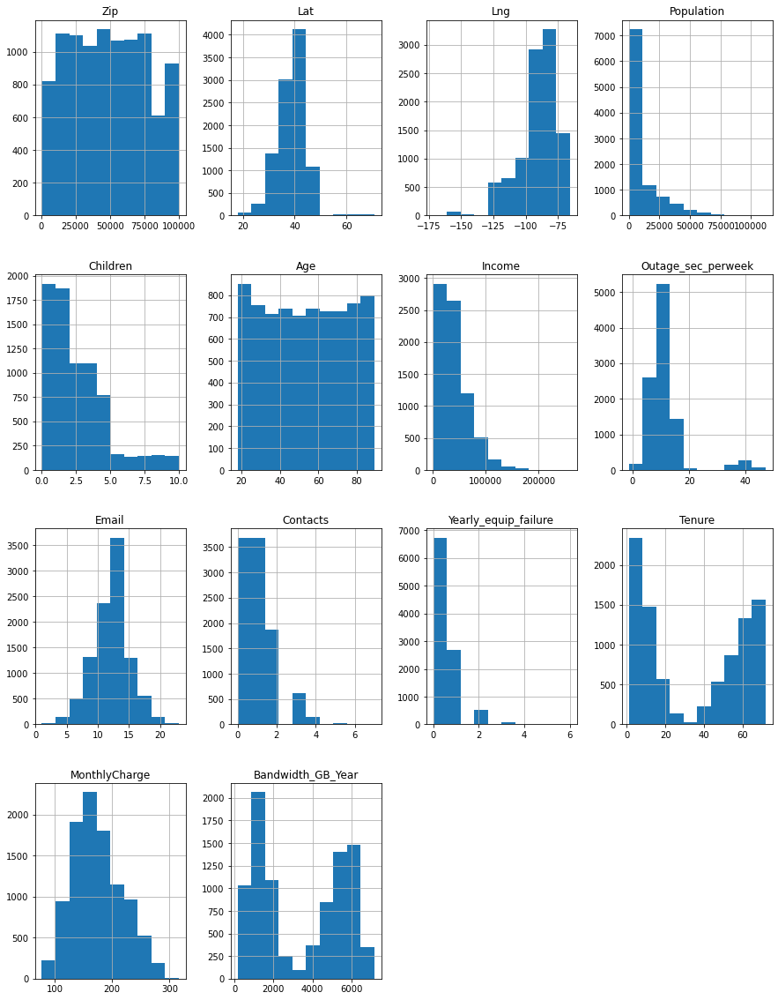

In [38]:
fig = plt.figure(figsize = (15,20))
df.hist(ax = fig.gca())

In [39]:
# ['Children', 'Age', 'Income', 'Techie', 'Phone', 'TechSupport', 'Tenure',' Bandwidth_GB_Year']
# Amount of coulmns with null values: 8
# 5 numerical variables and 3 categorical
# Numerical : ['Children', 'Age', 'Income', 'Tenure',' Bandwidth_GB_Year']
# Categorical : ['Techie', 'Phone', 'TechSupport']

### Numerical columns with null values

In [41]:
df.loc[:, ['Children', 'Age', 'Income', 'Tenure', 'Bandwidth_GB_Year']].isnull().sum()

Children             2495
Age                  2475
Income               2490
Tenure                931
Bandwidth_GB_Year    1021
dtype: int64

In [42]:
df.loc[:, ['Children', 'Age', 'Income', 'Tenure', 'Bandwidth_GB_Year']].head()

,Children,Age,Income,Tenure,Bandwidth_GB_Year
0,NaN,68.0,28561.99,6.795513,904.536110
1,1.0,27.0,21704.77,1.156681,800.982766
2,4.0,50.0,NaN,15.754144,2054.706961
3,1.0,48.0,18925.23,17.087227,2164.579412
4,0.0,83.0,40074.19,1.670972,271.493436


Because the distribution of the each variable is different I will use an IterativeImputer 
to impute all numerical values at ones. 

https://scikit-learn.org/stable/modules/impute.html

### Imputing numerical variables

In [43]:
from fancyimpute import IterativeImputer

In [44]:
# Copy df to df_mice_imputed
df_imputed = df.copy(deep=True)

# Initialize IterativeImputer
imputer = IterativeImputer()

# Impute using fit_tranform on the df
df_imputed.loc[:, ['Children', 'Age', 'Income', 'Tenure', 'Bandwidth_GB_Year']] = imputer.fit_transform(df.loc[:, ['Children', 'Age', 'Income', 'Tenure', 'Bandwidth_GB_Year']])

In [47]:
# Confirm that numerical variables were imputed
df_imputed.isnull().sum()

Customer_id                0
Interaction                0
City                       0
State                      0
County                     0
Zip                        0
Lat                        0
Lng                        0
Population                 0
Area                       0
Timezone                   0
Job                        0
Children                   0
Age                        0
Education                  0
Employment                 0
Income                     0
Marital                    0
Gender                     0
Churn                      0
Outage_sec_perweek         0
Email                      0
Contacts                   0
Yearly_equip_failure       0
Techie                  2477
Contract                   0
Port_modem                 0
Tablet                     0
InternetService            0
Phone                   1026
Multiple                   0
OnlineSecurity             0
OnlineBackup               0
DeviceProtection           0
TechSupport   

### Imputing categorical variables

In [50]:
# Checking categorical values
df_imputed[['Techie', 'Phone', 'TechSupport']].head(10)

,Techie,Phone,TechSupport
0,No,Yes,No
1,Yes,Yes,No
2,Yes,Yes,No
3,Yes,Yes,No
4,No,No,Yes
5,No,Yes,No
6,Yes,Yes,Yes
7,Yes,No,No
8,NaN,Yes,No
9,NaN,Yes,NaN


In [52]:
# Checking for unique values
print(df_imputed.Phone.unique())
print(df_imputed.Techie.unique())
print(df_imputed.TechSupport.unique())

['Yes' 'No' nan]
['No' 'Yes' nan]
['No' 'Yes' nan]


In [55]:
# Using OrdinalEncoder to encode categorical data 

from sklearn.preprocessing import OrdinalEncoder

# Making the encoder 
encoder = OrdinalEncoder()

In [56]:
# Encoding the categorical columns with null values
df_imputed[["Techie","Phone", "TechSupport"]] = encoder.fit_transform(df_imputed[["Techie","Phone", "TechSupport"]])

In [59]:
# Check columns imputed
df_imputed[["Techie","Phone", "TechSupport"]].head()

,Techie,Phone,TechSupport
0,0.0,1.0,0.0
1,1.0,1.0,0.0
2,1.0,1.0,0.0
3,1.0,1.0,0.0
4,0.0,0.0,1.0


In [65]:
from sklearn.impute import KNNImputer
imputer = KNNImputer()

In [68]:
# impute categorical values

df_knn_imputed = pd.DataFrame(np.round(imputer.fit_transform(df_imputed[["Techie","Phone", "TechSupport"]]))
                           ,columns = ["Techie","Phone", "TechSupport"])

In [69]:
df_knn_imputed.head(10)

,Techie,Phone,TechSupport
0,0.0,1.0,0.0
1,1.0,1.0,0.0
2,1.0,1.0,0.0
3,1.0,1.0,0.0
4,0.0,0.0,1.0
5,0.0,1.0,0.0
6,1.0,1.0,1.0
7,1.0,0.0,0.0
8,0.0,1.0,0.0
9,0.0,1.0,1.0


In [70]:
df_knn_imputed.isnull().sum()

Techie         0
Phone          0
TechSupport    0
dtype: int64

### Coverting the imputed values to the original categories

In [74]:
df_inverse_back = pd.DataFrame(encoder.inverse_transform(df_knn_imputed), columns = ["Techie","Phone", "TechSupport"])

In [76]:
df_inverse_back.head(10)

,Techie,Phone,TechSupport
0,No,Yes,No
1,Yes,Yes,No
2,Yes,Yes,No
3,Yes,Yes,No
4,No,No,Yes
5,No,Yes,No
6,Yes,Yes,Yes
7,Yes,No,No
8,No,Yes,No
9,No,Yes,Yes


In [79]:
df_imputed.head()

,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Techie,Contract,Port_modem,Tablet,InternetService,Phone,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
0,K409198,aa90260b-4141-4a24-8e36-b04ce1f4f77b,Point Baker,AK,Prince of Wales-Hyder,99927,56.25100,-133.37571,38,Urban,America/Sitka,Environmental health practitioner,1.726269,68.0,Master's Degree,Part Time,28561.990000,Widowed,Male,No,6.972566,10,0,1,0.0,One year,Yes,Yes,Fiber Optic,1.0,No,Yes,Yes,No,0.0,No,Yes,Yes,Credit Card (automatic),6.795513,171.449762,904.536110,5,5,5,3,4,4,3,4
1,S120509,fb76459f-c047-4a9d-8af9-e0f7d4ac2524,West Branch,MI,Ogemaw,48661,44.32893,-84.24080,10446,Urban,America/Detroit,"Programmer, multimedia",1.000000,27.0,Regular High School Diploma,Retired,21704.770000,Married,Female,Yes,12.014541,12,0,1,1.0,Month-to-month,No,Yes,Fiber Optic,1.0,Yes,Yes,No,No,0.0,Yes,Yes,Yes,Bank Transfer(automatic),1.156681,242.948015,800.982766,3,4,3,3,4,3,4,4
2,K191035,344d114c-3736-4be5-98f7-c72c281e2d35,Yamhill,OR,Yamhill,97148,45.35589,-123.24657,3735,Urban,America/Los_Angeles,Chief Financial Officer,4.000000,50.0,Regular High School Diploma,Student,39936.117211,Widowed,Female,No,10.245616,9,0,1,1.0,Two Year,Yes,No,DSL,1.0,Yes,No,No,No,0.0,No,Yes,Yes,Credit Card (automatic),15.754144,159.440398,2054.706961,4,4,2,4,4,3,3,3
3,D90850,abfa2b40-2d43-4994-b15a-989b8c79e311,Del Mar,CA,San Diego,92014,32.96687,-117.24798,13863,Suburban,America/Los_Angeles,Solicitor,1.000000,48.0,Doctorate Degree,Retired,18925.230000,Married,Male,No,15.206193,15,2,0,1.0,Two Year,No,No,DSL,1.0,No,Yes,No,No,0.0,Yes,No,Yes,Mailed Check,17.087227,120.249493,2164.579412,4,4,4,2,5,4,3,3
4,K662701,68a861fd-0d20-4e51-a587-8a90407ee574,Needville,TX,Fort Bend,77461,29.38012,-95.80673,11352,Suburban,America/Chicago,Medical illustrator,0.000000,83.0,Master's Degree,Student,40074.190000,Separated,Male,Yes,8.960316,16,2,1,0.0,Month-to-month,Yes,No,Fiber Optic,0.0,No,No,No,No,1.0,Yes,No,No,Mailed Check,1.670972,150.761216,271.493436,4,4,4,3,4,4,4,5


In [80]:
# Droping the categorical columns with missing values 
# add new columns with the imputed values and without null values

In [81]:
df_imputed.drop(columns=["Techie","Phone", "TechSupport"], axis=1 ,inplace=True)

In [82]:
# Double check that the columsn were dropped
df_imputed.head()

,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Contract,Port_modem,Tablet,InternetService,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
0,K409198,aa90260b-4141-4a24-8e36-b04ce1f4f77b,Point Baker,AK,Prince of Wales-Hyder,99927,56.25100,-133.37571,38,Urban,America/Sitka,Environmental health practitioner,1.726269,68.0,Master's Degree,Part Time,28561.990000,Widowed,Male,No,6.972566,10,0,1,One year,Yes,Yes,Fiber Optic,No,Yes,Yes,No,No,Yes,Yes,Credit Card (automatic),6.795513,171.449762,904.536110,5,5,5,3,4,4,3,4
1,S120509,fb76459f-c047-4a9d-8af9-e0f7d4ac2524,West Branch,MI,Ogemaw,48661,44.32893,-84.24080,10446,Urban,America/Detroit,"Programmer, multimedia",1.000000,27.0,Regular High School Diploma,Retired,21704.770000,Married,Female,Yes,12.014541,12,0,1,Month-to-month,No,Yes,Fiber Optic,Yes,Yes,No,No,Yes,Yes,Yes,Bank Transfer(automatic),1.156681,242.948015,800.982766,3,4,3,3,4,3,4,4
2,K191035,344d114c-3736-4be5-98f7-c72c281e2d35,Yamhill,OR,Yamhill,97148,45.35589,-123.24657,3735,Urban,America/Los_Angeles,Chief Financial Officer,4.000000,50.0,Regular High School Diploma,Student,39936.117211,Widowed,Female,No,10.245616,9,0,1,Two Year,Yes,No,DSL,Yes,No,No,No,No,Yes,Yes,Credit Card (automatic),15.754144,159.440398,2054.706961,4,4,2,4,4,3,3,3
3,D90850,abfa2b40-2d43-4994-b15a-989b8c79e311,Del Mar,CA,San Diego,92014,32.96687,-117.24798,13863,Suburban,America/Los_Angeles,Solicitor,1.000000,48.0,Doctorate Degree,Retired,18925.230000,Married,Male,No,15.206193,15,2,0,Two Year,No,No,DSL,No,Yes,No,No,Yes,No,Yes,Mailed Check,17.087227,120.249493,2164.579412,4,4,4,2,5,4,3,3
4,K662701,68a861fd-0d20-4e51-a587-8a90407ee574,Needville,TX,Fort Bend,77461,29.38012,-95.80673,11352,Suburban,America/Chicago,Medical illustrator,0.000000,83.0,Master's Degree,Student,40074.190000,Separated,Male,Yes,8.960316,16,2,1,Month-to-month,Yes,No,Fiber Optic,No,No,No,No,Yes,No,No,Mailed Check,1.670972,150.761216,271.493436,4,4,4,3,4,4,4,5


In [83]:
# Adding new columns with the imputed values 
df_without_nulls = pd.concat([df_imputed, df_inverse_back], axis=1, join='inner')

In [84]:
df_without_nulls

,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Contract,Port_modem,Tablet,InternetService,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8,Techie,Phone,TechSupport
0,K409198,aa90260b-4141-4a24-8e36-b04ce1f4f77b,Point Baker,AK,Prince of Wales-Hyder,99927,56.25100,-133.37571,38,Urban,America/Sitka,Environmental health practitioner,1.726269,68.000000,Master's Degree,Part Time,28561.990000,Widowed,Male,No,6.972566,10,0,1,One year,Yes,Yes,Fiber Optic,No,Yes,Yes,No,No,Yes,Yes,Credit Card (automatic),6.795513,171.449762,904.536110,5,5,5,3,4,4,3,4,No,Yes,No
1,S120509,fb76459f-c047-4a9d-8af9-e0f7d4ac2524,West Branch,MI,Ogemaw,48661,44.32893,-84.24080,10446,Urban,America/Detroit,"Programmer, multimedia",1.000000,27.000000,Regular High School Diploma,Retired,21704.770000,Married,Female,Yes,12.014541,12,0,1,Month-to-month,No,Yes,Fiber Optic,Yes,Yes,No,No,Yes,Yes,Yes,Bank Transfer(automatic),1.156681,242.948015,800.982766,3,4,3,3,4,3,4,4,Yes,Yes,No
2,K191035,344d114c-3736-4be5-98f7-c72c281e2d35,Yamhill,OR,Yamhill,97148,45.35589,-123.24657,3735,Urban,America/Los_Angeles,Chief Financial Officer,4.000000,50.000000,Regular High School Diploma,Student,39936.117211,Widowed,Female,No,10.245616,9,0,1,Two Year,Yes,No,DSL,Yes,No,No,No,No,Yes,Yes,Credit Card (automatic),15.754144,159.440398,2054.706961,4,4,2,4,4,3,3,3,Yes,Yes,No
3,D90850,abfa2b40-2d43-4994-b15a-989b8c79e311,Del Mar,CA,San Diego,92014,32.96687,-117.24798,13863,Suburban,America/Los_Angeles,Solicitor,1.000000,48.000000,Doctorate Degree,Retired,18925.230000,Married,Male,No,15.206193,15,2,0,Two Year,No,No,DSL,No,Yes,No,No,Yes,No,Yes,Mailed Check,17.087227,120.249493,2164.579412,4,4,4,2,5,4,3,3,Yes,Yes,No
4,K662701,68a861fd-0d20-4e51-a587-8a90407ee574,Needville,TX,Fort Bend,77461,29.38012,-95.80673,11352,Suburban,America/Chicago,Medical illustrator,0.000000,83.000000,Master's Degree,Student,40074.190000,Separated,Male,Yes,8.960316,16,2,1,Month-to-month,Yes,No,Fiber Optic,No,No,No,No,Yes,No,No,Mailed Check,1.670972,150.761216,271.493436,4,4,4,3,4,4,4,5,No,No,Yes
5,W303516,2b451d12-6c2b-4cea-a295-ba1d6bced078,Fort Valley,GA,Peach,31030,32.57032,-83.89040,17701,Urban,America/New_York,Chief Technology Officer,3.000000,83.000000,No Schooling Completed,Full Time,39935.628556,Never Married,Female,No,7.814859,15,3,1,One year,Yes,No,None,Yes,Yes,Yes,Yes,No,Yes,No,Electronic Check,7.000994,184.401558,1039.357983,3,3,3,2,4,3,3,3,No,Yes,No
6,U335188,6630d501-838c-4be4-a59c-6f58c814ed6a,Pioneer,TN,Scott,37847,36.43420,-84.27892,2535,Suburban,America/New_York,"Surveyor, hydrographic",0.000000,45.071945,Associate's Degree,Full Time,11467.500000,Widowed,Male,Yes,11.129094,10,0,1,Month-to-month,No,No,DSL,No,No,No,No,Yes,Yes,No,Electronic Check,13.236774,200.064886,1907.242972,6,5,6,4,1,5,5,5,Yes,Yes,Yes
7,V538685,70ddaa89-b726-49dc-9022-2d655e4c7936,Oklahoma City,OK,Oklahoma,73109,35.43313,-97.52463,23144,Suburban,America/Chicago,Sales promotion account executive,2.000000,53.821810,Bachelor's Degree,Full Time,26759.640000,Married,Female,Yes,7.594838,16,0,0,Month-to-month,No,No,DSL,No,No,Yes,No,No,No,Yes,Mailed Check,5.581628,114.754111,979.612708,2,2,2,5,2,3,4,5,Yes,No,No
8,M716771,05a49ee3-8fd5-453a-a5f3-82b6cd986856,Saint Cloud,FL,Osceola,34771,28.27646,-81.16273,17351,Suburban,America/New_York,Teaching laboratory technician,2.000000,49.000000,"Some College, Less than 1 Year",Full Time,58634.510000,Separated,Prefer not to answer,No,6.637259,20,2,3,Month-to-month,Yes,No,DSL,No,Yes,Yes,No,No,No,Yes,Bank Transfer(automatic),8.220686,118.366844,1312.874964,5,4,4,3,4,3,4,4,No,Yes,No
9,I676080,86f17e4d-2c24-4b70-a6ec-dddf0609dbaa,Cincinnati,OH,Hamilton,45237,39.19296,-84.45230,20193,Rural,America/New_York,Museu

In [85]:
df.columns

Index(['Customer_id', 'Interaction', 'City', 'State', 'County', 'Zip', 'Lat',
       'Lng', 'Population', 'Area', 'Timezone', 'Job', 'Children', 'Age',
       'Education', 'Employment', 'Income', 'Marital', 'Gender', 'Churn',
       'Outage_sec_perweek', 'Email', 'Contacts', 'Yearly_equip_failure',
       'Techie', 'Contract', 'Port_modem', 'Tablet', 'InternetService',
       'Phone', 'Multiple', 'OnlineSecurity', 'OnlineBackup',
       'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies',
       'PaperlessBilling', 'PaymentMethod', 'Tenure', 'MonthlyCharge',
       'Bandwidth_GB_Year', 'item1', 'item2', 'item3', 'item4', 'item5',
       'item6', 'item7', 'item8'],
      dtype='object')

### Reordering the DataFrame to the original order

In [88]:
df_without_nulls = df_without_nulls.reindex(columns=['Customer_id', 'Interaction', 'City', 'State', 'County', 'Zip', 'Lat',
       'Lng', 'Population', 'Area', 'Timezone', 'Job', 'Children', 'Age',
       'Education', 'Employment', 'Income', 'Marital', 'Gender', 'Churn',
       'Outage_sec_perweek', 'Email', 'Contacts', 'Yearly_equip_failure',
       'Techie', 'Contract', 'Port_modem', 'Tablet', 'InternetService',
       'Phone', 'Multiple', 'OnlineSecurity', 'OnlineBackup',
       'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies',
       'PaperlessBilling', 'PaymentMethod', 'Tenure', 'MonthlyCharge',
       'Bandwidth_GB_Year', 'item1', 'item2', 'item3', 'item4', 'item5',
       'item6', 'item7', 'item8'])

In [92]:
df_without_nulls.head(20)

,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Techie,Contract,Port_modem,Tablet,InternetService,Phone,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
0,K409198,aa90260b-4141-4a24-8e36-b04ce1f4f77b,Point Baker,AK,Prince of Wales-Hyder,99927,56.25100,-133.37571,38,Urban,America/Sitka,Environmental health practitioner,1.726269,68.000000,Master's Degree,Part Time,28561.990000,Widowed,Male,No,6.972566,10,0,1,No,One year,Yes,Yes,Fiber Optic,Yes,No,Yes,Yes,No,No,No,Yes,Yes,Credit Card (automatic),6.795513,171.449762,904.536110,5,5,5,3,4,4,3,4
1,S120509,fb76459f-c047-4a9d-8af9-e0f7d4ac2524,West Branch,MI,Ogemaw,48661,44.32893,-84.24080,10446,Urban,America/Detroit,"Programmer, multimedia",1.000000,27.000000,Regular High School Diploma,Retired,21704.770000,Married,Female,Yes,12.014541,12,0,1,Yes,Month-to-month,No,Yes,Fiber Optic,Yes,Yes,Yes,No,No,No,Yes,Yes,Yes,Bank Transfer(automatic),1.156681,242.948015,800.982766,3,4,3,3,4,3,4,4
2,K191035,344d114c-3736-4be5-98f7-c72c281e2d35,Yamhill,OR,Yamhill,97148,45.35589,-123.24657,3735,Urban,America/Los_Angeles,Chief Financial Officer,4.000000,50.000000,Regular High School Diploma,Student,39936.117211,Widowed,Female,No,10.245616,9,0,1,Yes,Two Year,Yes,No,DSL,Yes,Yes,No,No,No,No,No,Yes,Yes,Credit Card (automatic),15.754144,159.440398,2054.706961,4,4,2,4,4,3,3,3
3,D90850,abfa2b40-2d43-4994-b15a-989b8c79e311,Del Mar,CA,San Diego,92014,32.96687,-117.24798,13863,Suburban,America/Los_Angeles,Solicitor,1.000000,48.000000,Doctorate Degree,Retired,18925.230000,Married,Male,No,15.206193,15,2,0,Yes,Two Year,No,No,DSL,Yes,No,Yes,No,No,No,Yes,No,Yes,Mailed Check,17.087227,120.249493,2164.579412,4,4,4,2,5,4,3,3
4,K662701,68a861fd-0d20-4e51-a587-8a90407ee574,Needville,TX,Fort Bend,77461,29.38012,-95.80673,11352,Suburban,America/Chicago,Medical illustrator,0.000000,83.000000,Master's Degree,Student,40074.190000,Separated,Male,Yes,8.960316,16,2,1,No,Month-to-month,Yes,No,Fiber Optic,No,No,No,No,No,Yes,Yes,No,No,Mailed Check,1.670972,150.761216,271.493436,4,4,4,3,4,4,4,5
5,W303516,2b451d12-6c2b-4cea-a295-ba1d6bced078,Fort Valley,GA,Peach,31030,32.57032,-83.89040,17701,Urban,America/New_York,Chief Technology Officer,3.000000,83.000000,No Schooling Completed,Full Time,39935.628556,Never Married,Female,No,7.814859,15,3,1,No,One year,Yes,No,None,Yes,Yes,Yes,Yes,Yes,No,No,Yes,No,Electronic Check,7.000994,184.401558,1039.357983,3,3,3,2,4,3,3,3
6,U335188,6630d501-838c-4be4-a59c-6f58c814ed6a,Pioneer,TN,Scott,37847,36.43420,-84.27892,2535,Suburban,America/New_York,"Surveyor, hydrographic",0.000000,45.071945,Associate's Degree,Full Time,11467.500000,Widowed,Male,Yes,11.129094,10,0,1,Yes,Month-to-month,No,No,DSL,Yes,No,No,No,No,Yes,Yes,Yes,No,Electronic Check,13.236774,200.064886,1907.242972,6,5,6,4,1,5,5,5
7,V538685,70ddaa89-b726-49dc-9022-2d655e4c7936,Oklahoma City,OK,Oklahoma,73109,35.43313,-97.52463,23144,Suburban,America/Chicago,Sales promotion account executive,2.000000,53.821810,Bachelor's Degree,Full Time,26759.640000,Married,Female,Yes,7.594838,16,0,0,Yes,Month-to-month,No,No,DSL,No,No,No,Yes,No,No,No,No,Yes,Mailed Check,5.581628,114.754111,979.612708,2,2,2,5,2,3,4,5
8,M716771,05a49ee3-8fd5-453a-a5f3-82b6cd986856,Saint Cloud,FL,Osceola,34771,28.27646,-81.16273,17351,Suburban,America/New_York,Teaching laboratory technician,2.000000,49.000000,"Some College, Less than 1 Year",Full Time,58634.510000,Separated,Prefer not to answer,No,6.637259,20,2,3,No,Month-to-month,Yes,No,DSL,Yes,No,Yes,Yes,No,No,No,No,Yes,Bank Transfer(automatic),8.220686,118.366844,1312.874964,5,4,4,3,4,3,4,4
9,I676080,86f17e4d-2c24-4b70-a6ec-dddf0609dbaa,Cincinnati,OH,Hamilton,45237,39.19296,-84.45230,20193,Rural,America/New_York,Museu

In [90]:
df_without_nulls.isnull().sum()

Customer_id             0
Interaction             0
City                    0
State                   0
County                  0
Zip                     0
Lat                     0
Lng                     0
Population              0
Area                    0
Timezone                0
Job                     0
Children                0
Age                     0
Education               0
Employment              0
Income                  0
Marital                 0
Gender                  0
Churn                   0
Outage_sec_perweek      0
Email                   0
Contacts                0
Yearly_equip_failure    0
Techie                  0
Contract                0
Port_modem              0
Tablet                  0
InternetService         0
Phone                   0
Multiple                0
OnlineSecurity          0
OnlineBackup            0
DeviceProtection        0
TechSupport             0
StreamingTV             0
StreamingMovies         0
PaperlessBilling        0
PaymentMetho

In [91]:
# No null values in the Data set

### Checking for outliers in numerical columns

In [93]:
df_without_nulls.describe()

,Zip,Lat,Lng,Population,Children,Age,Income,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Tenure,MonthlyCharge,Bandwidth_GB_Year
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,49153.319600,38.757567,-90.782536,9756.562400,2.097902,53.237315,39936.760856,11.452955,12.016000,0.994200,0.398000,34.528841,174.076305,3392.384850
std,27532.196108,5.437389,15.156142,14432.698671,1.891275,18.246682,24575.114851,7.025921,3.025898,0.988466,0.635953,26.318964,43.335473,2175.255447
min,601.000000,17.966120,-171.688150,0.000000,0.000000,18.000000,740.660000,-1.348571,1.000000,0.000000,0.000000,-3.739684,77.505230,155.506715
25%,26292.500000,35.341828,-97.082812,738.000000,1.000000,40.945273,23660.790000,8.054362,10.000000,0.000000,0.000000,7.990060,141.071078,1235.908697
50%,48869.500000,39.395800,-87.918800,2910.500000,2.000000,53.348389,39935.646450,10.202896,12.000000,1.000000,0.000000,34.655625,169.915400,3388.774350
75%,71866.500000,42.106908,-80.088745,13168.000000,3.000000,65.970053,45504.192500,12.487644,14.000000,2.000000,1.000000,61.322793,203.777441,5573.800250
max,99929.000000,70.640660,-65.667850,111850.000000,10.000000,89.000000,258900.700000,47.049280,23.000000,7.000000,6.000000,77.245270,315.878600,7158.982000


<ipython-input-95-dbd7b80d08a7>:2: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  df_without_nulls.hist(ax = fig.gca())


array([[<AxesSubplot:title={'center':'Zip'}>,
        <AxesSubplot:title={'center':'Lat'}>,
        <AxesSubplot:title={'center':'Lng'}>,
        <AxesSubplot:title={'center':'Population'}>],
       [<AxesSubplot:title={'center':'Children'}>,
        <AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Income'}>,
        <AxesSubplot:title={'center':'Outage_sec_perweek'}>],
       [<AxesSubplot:title={'center':'Email'}>,
        <AxesSubplot:title={'center':'Contacts'}>,
        <AxesSubplot:title={'center':'Yearly_equip_failure'}>,
        <AxesSubplot:title={'center':'Tenure'}>],
       [<AxesSubplot:title={'center':'MonthlyCharge'}>,
        <AxesSubplot:title={'center':'Bandwidth_GB_Year'}>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

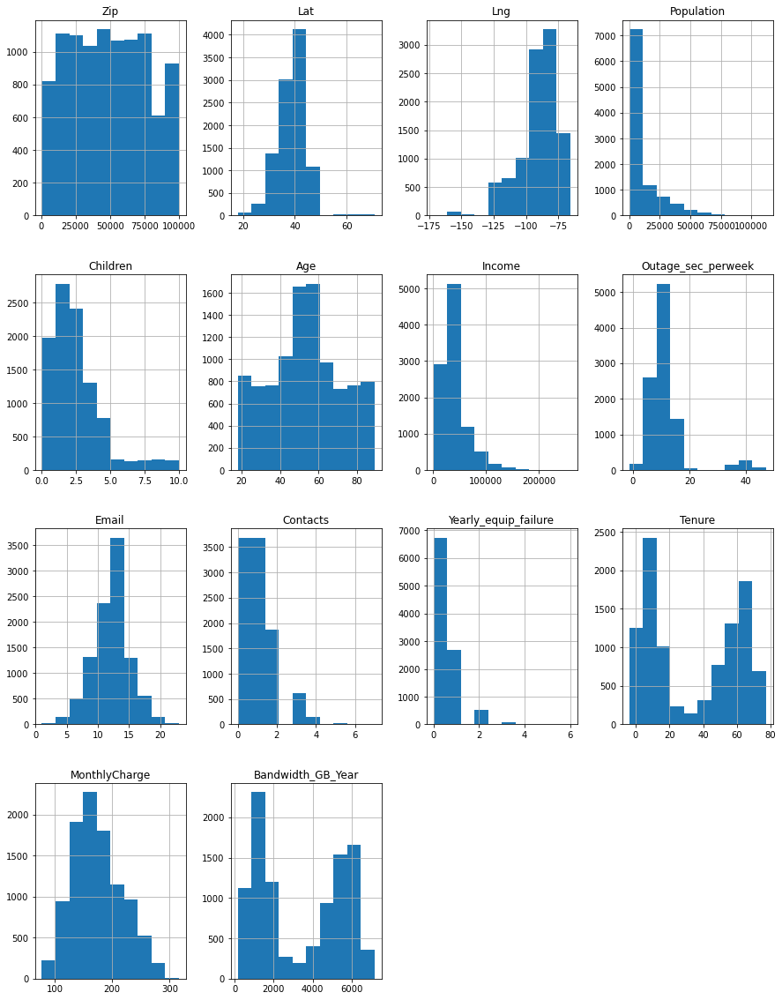

In [95]:
fig = plt.figure(figsize = (15,20))
df_without_nulls.hist(ax = fig.gca())

In [109]:
num_col = df_without_nulls.describe().columns

In [110]:
num_col

Index(['Zip', 'Lat', 'Lng', 'Population', 'Children', 'Age', 'Income',
       'Outage_sec_perweek', 'Email', 'Contacts', 'Yearly_equip_failure',
       'Tenure', 'MonthlyCharge', 'Bandwidth_GB_Year'],
      dtype='object')

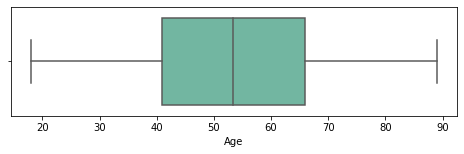

In [121]:
fig = plt.figure(figsize = (8,2))
ax = sns.boxplot(x='Age', data=df_without_nulls, orient='h', palette='Set2')

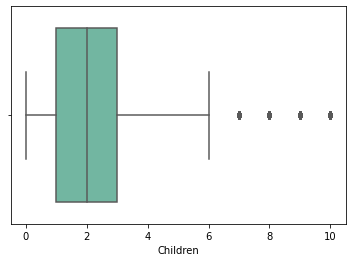

In [120]:
ax = sns.boxplot(x='Children', data=df_without_nulls, orient='h', palette='Set2')

In [126]:
len(df[df.Children > 7])

302

In [127]:
len(df_without_nulls[df_without_nulls.Children > 7])

302

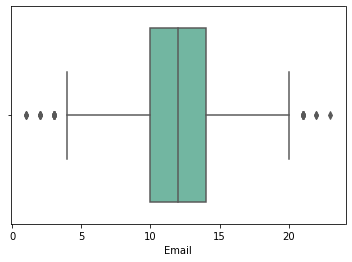

In [128]:
ax = sns.boxplot(x='Email', data=df_without_nulls, orient='h', palette='Set2')

In [129]:
df_without_nulls.Email.unique()

array([10, 12,  9, 15, 16, 20, 18, 17, 14, 13, 11,  8,  6,  5, 19,  3,  7,
       21,  4,  2,  1, 23, 22])

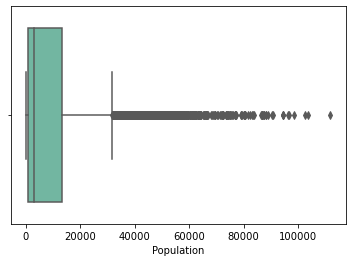

In [131]:
ax = sns.boxplot(x='Population', data=df_without_nulls, orient='h', palette='Set2')

In [132]:
df_without_nulls.Population

0           38
1        10446
2         3735
3        13863
4        11352
5        17701
6         2535
7        23144
8        17351
9        20193
10         555
11       33372
12         556
13           0
14        8165
15        2093
16       50079
17        7249
18        9463
19        3177
20          69
21       14440
22         381
23        2193
24        9434
25       29568
26        3089
27        5652
28        1716
29       52484
30       11268
31        1765
32         680
33         136
34        1517
35       14103
36        6394
37        5059
38       20450
39        2123
40        1164
41          23
42         895
43        6699
44       35743
45         320
46        7870
47         861
48       15364
49        2589
50        4901
51       39649
52         456
53          94
54         315
55        4969
56       46869
57       58431
58       26182
59         694
60        3093
61        2765
62        3757
63        4938
64        3761
65        1851
66       3

In [136]:
df_without_nulls[df_without_nulls.Population > 50000]

,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Techie,Contract,Port_modem,Tablet,InternetService,Phone,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
16,V847470,bbf5ca9f-cb89-44ea-ac42-3f5862ebdbd0,Modesto,CA,Stanislaus,95351,37.62326,-120.99637,50079,Urban,America/Los_Angeles,Applications developer,2.733443,63.000000,"Some College, 1 or More Years, No Degree",Retired,31659.300000,Married,Female,Yes,14.429165,13,1,0,No,Month-to-month,Yes,No,DSL,Yes,Yes,No,Yes,Yes,No,No,Yes,Yes,Bank Transfer(automatic),15.782150,195.872604,2070.376729,3,4,4,3,5,4,4,3
29,Z686376,cddc4b08-7aae-4194-a75c-28bbcc8257f3,Silver Spring,MD,Montgomery,20902,39.04373,-77.04224,52484,Suburban,America/New_York,"Radiographer, diagnostic",4.000000,69.000000,Bachelor's Degree,Student,39935.968176,Never Married,Male,Yes,12.354372,18,1,0,No,Two Year,No,Yes,DSL,Yes,Yes,Yes,Yes,Yes,No,Yes,Yes,Yes,Credit Card (automatic),5.425865,259.387918,1745.125956,4,4,4,3,2,5,5,4
57,C101444,5ed9b266-29a0-489e-88e0-59f9a0b39e49,Goleta,CA,Santa Barbara,93117,34.49127,-120.08222,58431,Rural,America/Los_Angeles,Professor Emeritus,1.558408,33.000000,Bachelor's Degree,Full Time,15690.250000,Widowed,Female,No,11.310199,11,0,1,No,Two Year,No,No,None,Yes,No,Yes,No,Yes,Yes,No,Yes,Yes,Mailed Check,6.732949,142.377023,958.139706,4,5,5,5,4,4,4,5
90,G491883,0319a159-cefc-4d57-804b-c5a16de84ca6,Greensboro,NC,Guilford,27410,36.11785,-79.89432,55519,Rural,America/New_York,Chiropodist,0.000000,75.000000,"Some College, Less than 1 Year",Unemployed,58482.900000,Separated,Female,Yes,7.832112,13,0,0,No,Month-to-month,No,No,Fiber Optic,Yes,Yes,No,No,Yes,No,No,Yes,Yes,Mailed Check,2.188919,192.008448,554.936904,3,3,3,3,3,4,3,3
100,O967373,57582d0e-06d5-453f-934f-cd35554c860c,Birmingham,AL,Shelby,35242,33.42521,-86.67144,55122,Urban,America/Chicago,Pharmacologist,2.419097,69.000000,Nursery School to 8th Grade,Full Time,58077.380000,Separated,Male,Yes,10.822104,12,1,1,No,Month-to-month,No,No,None,No,No,No,Yes,Yes,Yes,Yes,Yes,Yes,Credit Card (automatic),14.462882,222.799925,1806.135733,3,2,3,5,3,4,4,3
157,K265986,9f0486c9-e0fc-4762-8f35-e676fbefb689,League City,TX,Galveston,77573,29.50205,-95.08652,86926,Rural,America/Chicago,Visual merchandiser,1.000000,39.000000,"9th Grade to 12th Grade, No Diploma",Full Time,39935.594346,Divorced,Male,No,7.519193,9,2,1,Yes,Two Year,No,Yes,Fiber Optic,Yes,No,Yes,Yes,No,Yes,Yes,No,Yes,Electronic Check,5.969967,175.495369,967.981914,4,5,4,4,3,3,3,5
203,K33780,10a165f2-6ce5-47ff-bec5-925b3d5eebf0,Chicago,IL,Cook,60639,41.92056,-87.75603,90517,Suburban,America/Chicago,Merchant navy officer,3.000000,83.000000,Regular High School Diploma,Full Time,44223.580000,Widowed,Female,No,8.339727,15,2,0,No,Month-to-month,Yes,No,None,Yes,No,No,Yes,No,No,Yes,No,No,Electronic Check,12.030853,128.445831,1430.761492,2,3,1,3,3,1,4,3
212,X914490,b0115cfa-cd5e-42a3-9254-93e3ee76c6a2,Cupertino,CA,Santa Clara,95014,37.30493,-122.08070,62430,Rural,America/Los_Angeles,"Engineer, petroleum",3.000000,81.000000,"9th Grade to 12th Grade, No Diploma",Retired,92447.710000,Divorced,Female,No,14.827726,12,0,0,No,One year,No,No,DSL,Yes,Yes,Yes,Yes,No,No,No,No,Yes,Bank Transfer(automatic),1.416593,149.680349,757.009707,4,4,4,3,3,3,3,3
240,D402022,6d812827-f099-4d10-972a-9babadb6e85d,Chicago,IL,Cook,60630,41.97215,-87.75706,57344,Rural,America/Chicago,"Producer, television/film/video",2.747306,46.685120,Bachelor's Degree,Retired,25611.290000,Divorced,Male,No,13.332242,11,0,0,No,Month-to-month,No,No,DSL,Yes,No,No,No,No,No,Yes,Yes,No,Electronic Check,20.354560,187.504587,2512.364940,4,4,4,3,3,4,5,4
291,J227266,b6a53542-a36f-4b73-b2c5-f04b7eafc8bd,Germantown,MD,Montgomery,20874,39.12972,-77.29750

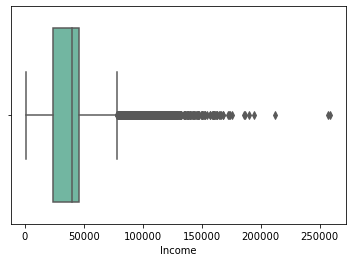

In [137]:
ax = sns.boxplot(x='Income', data=df_without_nulls, orient='h', palette='Set2')

In [140]:
df_without_nulls[df_without_nulls.Income > 80000]

,Customer_id,Interaction,City,State,County,Zip,Lat,Lng,Population,Area,Timezone,Job,Children,Age,Education,Employment,Income,Marital,Gender,Churn,Outage_sec_perweek,Email,Contacts,Yearly_equip_failure,Techie,Contract,Port_modem,Tablet,InternetService,Phone,Multiple,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,PaymentMethod,Tenure,MonthlyCharge,Bandwidth_GB_Year,item1,item2,item3,item4,item5,item6,item7,item8
12,F139569,4828f66e-5592-4c61-bbf4-313cf8731f1c,Conesville,IA,Muscatine,52739,41.37287,-91.36865,556,Rural,America/Chicago,"Engineer, broadcasting (operations)",0.000000,83.000000,Master's Degree,Retired,83671.08,Divorced,Male,No,7.265961,9,0,0,No,Month-to-month,Yes,No,Fiber Optic,Yes,No,No,No,No,No,Yes,No,No,Bank Transfer(automatic),13.011492,136.431239,1196.388018,1,2,1,4,3,2,3,3
13,X44200,780992d3-d758-4152-aceb-5d59edda3d15,East Livermore,ME,Androscoggin,4228,44.43256,-70.11501,0,Urban,America/New_York,Learning disability nurse,5.000000,55.299202,No Schooling Completed,Retired,115114.57,Separated,Female,No,6.568344,14,1,0,No,Two Year,Yes,Yes,Fiber Optic,Yes,Yes,Yes,No,No,Yes,Yes,No,Yes,Bank Transfer(automatic),16.879220,185.659294,1948.694497,5,6,5,2,4,5,4,4
15,A403906,df437bd4-bd8a-4c8f-8110-11ed1a7723ea,Saint Germain,WI,Vilas,54558,45.92342,-89.50138,2093,Suburban,America/Chicago,Amenity horticulturist,2.383166,39.000000,Bachelor's Degree,Full Time,89061.45,Divorced,Male,Yes,9.482219,13,1,0,No,One year,No,No,None,Yes,No,Yes,No,No,No,Yes,Yes,Yes,Electronic Check,13.870013,176.334509,1840.014467,3,3,3,2,4,3,5,2
46,B609739,bb4a7c2d-6524-41d6-b2ed-f7511509ff5b,Peoria,IL,Peoria,61606,40.69980,-89.61143,7870,Suburban,America/Chicago,Broadcast presenter,1.908416,23.000000,Associate's Degree,Retired,132116.33,Divorced,Male,Yes,12.609107,11,1,0,No,Month-to-month,Yes,No,Fiber Optic,Yes,No,Yes,Yes,No,Yes,No,Yes,Yes,Bank Transfer(automatic),22.257460,185.071940,2384.885909,4,4,5,2,2,4,3,3
56,L384793,79c4473e-fd88-46bc-a276-e21783d598eb,Alvin,TX,Brazoria,77511,29.38147,-95.24205,46869,Suburban,America/Chicago,Legal executive,1.000000,73.000000,"9th Grade to 12th Grade, No Diploma",Full Time,82634.86,Married,Male,Yes,9.531952,11,0,1,No,Month-to-month,No,No,DSL,Yes,No,No,Yes,No,No,No,No,Yes,Electronic Check,9.563363,116.095233,1324.330108,5,4,3,5,3,3,5,4
61,O942919,176d7713-b919-41c3-badf-676dc1abbf07,Delavan,IL,Tazewell,61734,40.37342,-89.52646,2765,Urban,America/Chicago,Recruitment consultant,1.000000,25.000000,Bachelor's Degree,Full Time,81831.49,Widowed,Male,No,39.883903,10,3,0,No,Month-to-month,Yes,No,Fiber Optic,Yes,Yes,No,No,Yes,Yes,Yes,No,No,Electronic Check,2.344875,225.294747,704.754041,3,4,3,2,3,4,2,4
62,I167253,d73797a9-ae43-4fe0-8f43-c7db6456eee8,Harveys Lake,PA,Luzerne,18618,41.37478,-76.03486,3757,Rural,America/New_York,Commercial horticulturist,0.000000,42.000000,"Some College, 1 or More Years, No Degree",Full Time,100076.65,Separated,Female,Yes,8.599584,14,3,0,No,Month-to-month,Yes,No,DSL,Yes,No,Yes,Yes,No,No,No,Yes,Yes,Mailed Check,7.960490,150.261603,1416.444695,5,5,5,4,3,2,4,4
75,E330599,99348a66-489f-42a7-894a-178bc1ba030c,Inglewood,CA,Los Angeles,90303,33.93810,-118.33230,24693,Rural,America/Los_Angeles,Sports therapist,2.000000,67.000000,Regular High School Diploma,Retired,81124.71,Married,Female,Yes,13.647072,13,0,0,No,One year,Yes,Yes,DSL,Yes,Yes,Yes,Yes,Yes,Yes,Yes,Yes,Yes,Electronic Check,5.434646,271.374478,1648.102673,3,3,4,3,5,3,3,4
92,K581313,87ec7c0f-2780-4909-9bf3-5369082eab90,Reading,MI,Hillsdale,49274,41.83849,-84.76277,3499,Suburban,America/Detroit,"Designer, television/film set",0.000000,68.000000,"Some College, Less than 1 Year",Student,115510.46,Separated,Female,No,5.655483,3,1,0,No,Two Year,Yes,No,Fiber Optic,Yes,No,Yes,No,No,Yes,No,Yes,Yes,Electronic Check,3.273341,163.040404,443.984031,2,2,2,4,3,3,4,3
98,R180138,7def992e-acd6-4b3e-9d01-68812f5fd2ff,Fayetteville,NC,Cumberland,28301,35.07431,-78.88358,17600,Rural,America/New_York,Chief 

In [ ]:
df_without_nulls[df_without_nulls.Income > 250000]